In [1]:
import pandas as pd
from sklearn.model_selection import train_test_split
import sys

In [2]:
import numpy as np

In [3]:
sys.path.insert(0, "../Tools")

In [4]:
from PandasDataframeDriver import manipulator

In [5]:
dataObj = manipulator("../Data/MasterData")

In [6]:
df = dataObj.data

In [7]:
print(df)

rock_id                                        380.1     380.9     381.6  \
MasterData\Biotite1_0.9__version1_1         0.943437  0.953268  0.949573   
MasterData\Biotite1_0.9__version1_2         0.931866  0.943725  0.941908   
MasterData\Biotite1_0.9__version1_3         0.901200  0.915342  0.916241   
MasterData\Biotite1_0.9__version1_4         0.930291  0.942652  0.942058   
MasterData\Biotite1_0.9__version1_5         0.895164  0.907664  0.907929   
MasterData\Biotite1_0.9__version1_6         0.913531  0.929462  0.932439   
MasterData\Biotite1_0.9__version1_7         0.957227  0.970424  0.969861   
MasterData\Biotite1_0.9__version1_8         0.949151  0.961870  0.960151   
MasterData\Biotite1_0.9__version1_9         0.920094  0.932414  0.931351   
MasterData\Biotite1_0.9__version1_10        0.932058  0.944483  0.944516   
MasterData\Biotite1_0.9__version1_11        0.921731  0.934504  0.934861   
MasterData\Biotite1_0.9__version1_12        0.917748  0.930056  0.929820   
MasterData\B

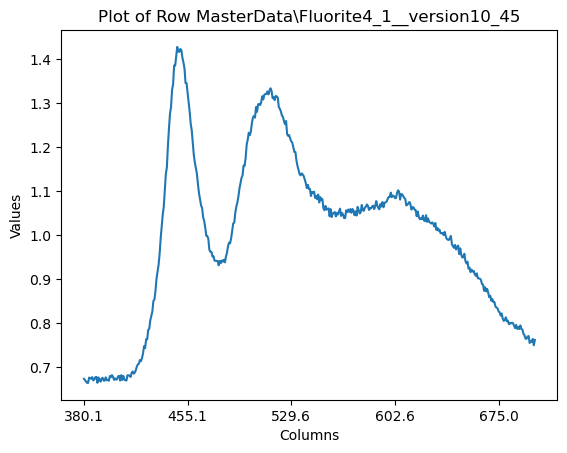

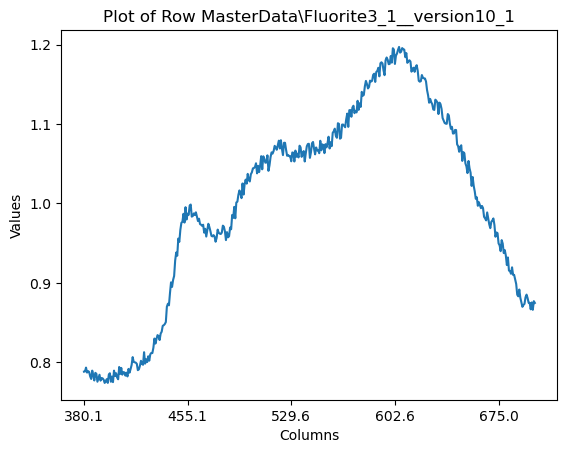

In [9]:
dataObj.plot_rows(["MasterData\Fluorite4_1__version10_45", "MasterData\Fluorite3_1__version10_1"])

In [7]:
X = pd.get_dummies(df.drop(["target"], axis=1))
y = pd.get_dummies(df["target"])

In [8]:
y.shape

(78870, 6)

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=.25)

In [13]:
y_train.head()

,0,1,2,3,4,5
MasterData\Biotite2_0.99__version11_58,True,False,False,False,False,False
MasterData\Quartz1_0.99__version7_43,False,False,False,False,False,True
MasterData\Quartz2_0.99__version5_24,False,False,False,False,False,True
MasterData\Calcite2_1__version3_49,False,True,False,False,False,False
MasterData\Galena1_1.01__version1_22,False,False,False,True,False,False


In [14]:
X_train.head()

rock_id,380.1,380.9,381.6,382.4,383.1,383.9,384.6,385.4,386.1,386.9,...,694.7,695.4,696.2,696.9,697.6,698.4,699.1,699.8,700.5,2.0
MasterData\Biotite2_0.99__version11_58,0.599212,0.594977,0.593837,0.603152,0.605898,0.603327,0.609849,0.608285,0.604702,0.609587,...,0.726325,0.724731,0.722004,0.716404,0.722547,0.711939,0.713529,0.711116,0.720384,0.574384
MasterData\Quartz1_0.99__version7_43,0.581637,0.576377,0.575894,0.574479,0.580521,0.576933,0.576690,0.586301,0.578096,0.587669,...,0.703959,0.698376,0.691657,0.684690,0.691621,0.688846,0.673126,0.680895,0.674498,0.530914
MasterData\Quartz2_0.99__version5_24,0.386881,0.384032,0.387848,0.386240,0.384298,0.386740,0.388539,0.387523,0.394523,0.389945,...,0.477025,0.479519,0.470577,0.472143,0.471613,0.470117,0.468942,0.467730,0.464329,0.390961
MasterData\Calcite2_1__version3_49,0.603028,0.599094,0.607101,0.610722,0.607997,0.607446,0.609894,0.606685,0.609217,0.609761,...,0.733629,0.732847,0.728058,0.731944,0.719025,0.714429,0.714765,0.708565,0.705757,0.568233
MasterData\Galena1_1.01__version1_22,0.496135,0.495688,0.500196,0.498701,0.494396,0.496707,0.490900,0.489003,0.494746,0.496596,...,0.605031,0.612164,0.608492,0.604303,0.595585,0.593569,0.591893,0.595152,0.589037,0.469791


**Import Dependencies**

In [15]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import accuracy_score

In [16]:
opt_1 = Adam(learning_rate=0.001)

**Build and Compile Model**

In [17]:
model = Sequential([
    Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(X_train.shape[1], 1)),
    MaxPooling1D(pool_size=2),
    Conv1D(filters=128, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Conv1D(filters=128, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Conv1D(filters=128, kernel_size=3, activation='relu'),
    MaxPooling1D(pool_size=2),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(6, activation='softmax')
])

In [18]:
model.compile(loss='categorical_crossentropy', optimizer=opt_1, metrics=['accuracy'])

**Fit, Predict and Evaluate**

In [19]:
hist = model.fit(X_train, y_train, epochs=30, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 31s 19ms/step - accuracy: 0.4599 - loss: 1.2614 - val_accuracy: 0.7407 - val_loss: 0.6652
Epoch 2/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 32s 22ms/step - accuracy: 0.7311 - loss: 0.6799 - val_accuracy: 0.7378 - val_loss: 0.6285
Epoch 3/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 30s 21ms/step - accuracy: 0.7921 - loss: 0.4991 - val_accuracy: 0.8448 - val_loss: 0.4047
Epoch 4/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 32s 21ms/step - accuracy: 0.8332 - loss: 0.4059 - val_accuracy: 0.8532 - val_loss: 0.3654
Epoch 5/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 33s 22ms/step - accuracy: 0.8568 - loss: 0.3549 - val_accuracy: 0.8795 - val_loss: 0.3044
Epoch 6/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 32s 22ms/step - accuracy: 0.8737 - loss: 0.3178 - val_accuracy: 0.8918 - val_loss: 0.2781
Epoch 7/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 33s 22ms/step - accuracy: 0.8883 - loss: 0.2837 - val_accuracy: 0.8450 - val_loss: 0.3814
Epoch 8/30
1479/1479 ━━━━━━━━━━━━━━━━━━━━ 32s 22ms/step - accuracy: 0.8956 -

In [20]:
import matplotlib.pyplot as plt

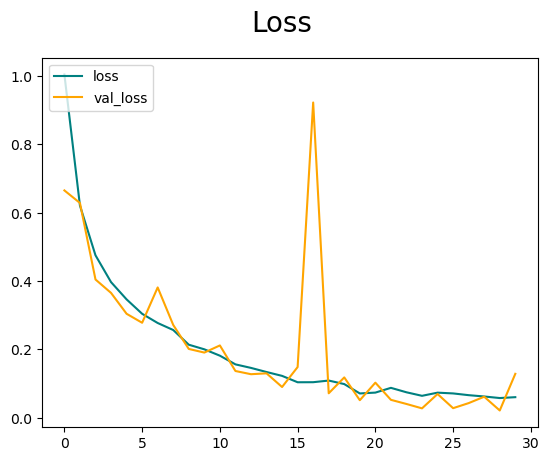

In [21]:
fig = plt.figure()
plt.plot(hist.history['loss'], color='teal', label='loss')
plt.plot(hist.history['val_loss'], color='orange', label='val_loss')
fig.suptitle('Loss', fontsize=20)
plt.legend(loc="upper left")
plt.show()

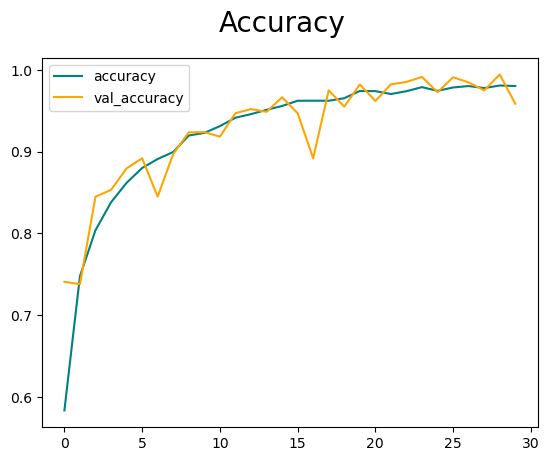

In [22]:
fig = plt.figure()
plt.plot(hist.history['accuracy'], color='teal', label='accuracy')
plt.plot(hist.history['val_accuracy'], color='orange', label='val_accuracy')
fig.suptitle('Accuracy', fontsize=20)
plt.legend(loc="upper left")
plt.show()

In [23]:
y_hat = model.predict(X_test)

493/493 ━━━━━━━━━━━━━━━━━━━━ 5s 9ms/step


In [24]:
y_hat = [(np.where(val == val.max()))[0][0] for val in y_hat]

In [25]:
y_hat

[2,
 1,
 4,
 0,
 3,
 5,
 0,
 0,
 5,
 2,
 2,
 1,
 5,
 5,
 1,
 0,
 5,
 3,
 1,
 4,
 0,
 4,
 1,
 2,
 0,
 5,
 0,
 0,
 5,
 0,
 5,
 0,
 2,
 0,
 4,
 4,
 1,
 0,
 2,
 1,
 4,
 3,
 3,
 2,
 4,
 3,
 4,
 0,
 3,
 4,
 1,
 3,
 1,
 2,
 1,
 0,
 0,
 5,
 2,
 2,
 1,
 5,
 0,
 5,
 1,
 1,
 0,
 2,
 1,
 2,
 4,
 5,
 5,
 4,
 5,
 5,
 1,
 5,
 2,
 0,
 5,
 4,
 2,
 0,
 0,
 1,
 5,
 4,
 3,
 1,
 1,
 3,
 0,
 5,
 2,
 5,
 2,
 1,
 5,
 2,
 5,
 5,
 1,
 1,
 1,
 2,
 1,
 2,
 5,
 0,
 4,
 1,
 3,
 0,
 1,
 0,
 0,
 0,
 1,
 3,
 5,
 5,
 5,
 0,
 5,
 5,
 2,
 5,
 5,
 0,
 2,
 0,
 0,
 3,
 0,
 0,
 1,
 5,
 2,
 0,
 0,
 4,
 1,
 2,
 0,
 5,
 5,
 2,
 1,
 1,
 4,
 3,
 2,
 5,
 5,
 4,
 3,
 0,
 2,
 4,
 1,
 1,
 5,
 1,
 1,
 4,
 4,
 0,
 2,
 1,
 1,
 0,
 3,
 2,
 5,
 5,
 2,
 2,
 4,
 2,
 1,
 4,
 5,
 0,
 0,
 4,
 0,
 2,
 2,
 0,
 0,
 5,
 0,
 0,
 4,
 0,
 5,
 1,
 2,
 2,
 0,
 1,
 4,
 0,
 2,
 3,
 1,
 5,
 1,
 0,
 0,
 2,
 5,
 5,
 2,
 2,
 4,
 4,
 1,
 0,
 0,
 2,
 2,
 1,
 2,
 2,
 1,
 2,
 2,
 0,
 0,
 4,
 3,
 1,
 2,
 3,
 4,
 5,
 3,
 5,
 0,
 1,
 0,
 0,
 3,
 1,
 4,
 5,
 4,
 2,


In [26]:
y_test = y_test.idxmax(axis=1)

In [27]:
y_test

MasterData\Fluorite2_1.1__version11_23        2
MasterData\Calcite3Sync_0.99__version5_12     1
MasterData\Hematite1_1.1__version11_60        4
MasterData\Biotite3_1__version8_3             0
MasterData\Biotite2_0.99__version5_53         0
MasterData\Quartz1_1__version11_29            5
MasterData\Biotite2_1__version1_7             0
MasterData\Biotite2_0.9__version5_26          0
MasterData\Quartz1_1.1__version6_16           5
MasterData\Fluorite4_1.1__version9_42         2
MasterData\Fluorite3_1.1__version10_25        2
MasterData\Quartz3_0.99__version10_1          5
MasterData\Quartz4_0.99__version6_40          5
MasterData\Quartz4_1.01__version3_43          5
MasterData\Calcite3_0.99__version6_2          1
MasterData\Biotite1_1.01__version1_60         0
MasterData\Quartz1_0.99__version11_52         5
MasterData\Galena2_1.01__version3_55          3
MasterData\Calcite3_1__version5_55            1
MasterData\Hematite2_1.01__version5_5         4
MasterData\Biotite4_1__version10_31     

In [28]:
accuracy_score(y_test, y_hat) 

0.9552428046151895

**Saving and Reloading**

In [29]:
import os

In [30]:
model.save('Master7.keras')